## Import Packages and Load the Data

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
from google.colab import drive
drive.mount('/content/drive')
!pip install dataprep
 #Website for syntax https://sfu-db.github.io/dataprep/user_guide/eda/titanic.html
from dataprep.eda import plot_correlation
from dataprep.eda import plot
from dataprep.eda import create_report
import seaborn as sns
sns.set(rc={'figure.figsize':(30,8.27)})
import statsmodels.regression.linear_model as sm
import statsmodels.api as sm

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


<Figure size 640x480 with 0 Axes>

Vivino is the “go-to” app when you want to discover good wines, especially on a student budget. Thus, the prices range from 50-6000 DKK a bottle, so it should be possible finding a wine matching almost everyone preference and budget. After couple of hunts for good affordable wines, we started wondering: what drives the rating at Vivino? What countries and regions should I look against to find high rated “cheap” wines.


Vivino is a Danish founded company and is today the most downloaded wine app, used by more than 26 million users around the world. With millions of wines featured, the database makes up the most extensive wine library in the world. Vivino has established a community and developed an app, which especially is great for us who love red wine but aren’t sommeliers-in-training. The Vivino app enables consumers to snap a photo of a bottle’s label, and the app will immediately pull up information about the wine, its rating score, reviews and much more.

## Importing the data

In [2]:
df = pd.read_csv('/content/drive/MyDrive/Project Vivino Own Files/all_vintages.csv')  
df1 = pd.read_csv('/content/drive/MyDrive/Project Vivino Own Files/all_reviews_and_users.csv')

## Basic Description of the Data



The reader must note, that we are operating via two DataFramnes. One called "All vintages" and "All reviews and users". The quantitative data is contained in "All vintages" and the reviews and user information is contained in "All reviews and users".

In [3]:
df.describe()


/usr/local/lib/python3.6/dist-packages/numpy/lib/function_base.py:3968: RuntimeWarning: invalid value encountered in multiply
  x2 = take(ap, indices_above, axis=axis) * weights_above


,Unnamed: 0,Unnamed: 0.1,ratings_count,ratings_average,labels_count,reviews_count,wine_id,winery_id,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,region_id,users_count,regions_count,wines_count,wineries_count,median_price,price,top_world_pct,top_region_pct,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,average_ratings,net_follower_score
count,77916.000000,77916.000000,77916.000000,77916.000000,77916.000000,77916.000000,7.791600e+04,77916.000000,77916.000000,77916.000000,7.791600e+04,77916.000000,77916.000000,7.791600e+04,77916.000000,77916.000000,77916.000000,77916.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,45231.000000,31969.000000,3.196900e+04
mean,38957.500000,38957.500000,840.901612,3.634477,4137.359028,188.681670,1.502292e+06,37848.184352,51328.271292,3.769701,3.724667e+05,55.283010,986.326120,3.091653e+06,463.800593,225959.960303,28529.908928,324.046623,401.389839,6.964162,11.366054,0.244659,0.186573,0.143685,0.141083,0.067870,0.014529,0.028869,0.016073,0.050480,0.057587,0.017555,0.013410,0.017627,0.786629,0.631912,0.288232,0.697928,0.124959,0.123809,0.114368,0.444916,0.030908,830.752957,3.715019,inf
std,22492.556124,22492.556124,2549.737010,0.781307,9059.478343,372.479957,1.462247e+06,65088.160888,72580.137821,0.276632,5.542907e+05,68.186469,914.266883,2.752410e+06,459.332317,171160.227409,22625.918589,2724.206963,5046.826797,6.021509,9.468374,0.128427,0.122021,0.118281,0.075745,0.051845,0.028847,0.042013,0.028715,0.099113,0.116316,0.030740,0.017126,0.048744,0.409692,0.482291,0.452944,0.459161,0.330676,0.329367,0.318262,0.496962,0.173070,1286.719806,0.202009,NaN
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000e+01,24.000000,21.000000,2.400000,3.690000e+02,1.000000,7.000000,4.415000e+03,1.000000,268.000000,39.000000,0.000000,0.010000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.500000,0.000000e+00
25%,19478.750000,19478.750000,94.000000,3.500000,468.000000,27.000000,7.793330e+05,3107.000000,7561.250000,3.600000,5.127100e+04,11.000000,429.000000,8.201340e+05,91.000000,47366.000000,5410.000000,63.850000,65.310000,2.000000,4.000000,0.166667,0.098522,0.069964,0.088661,0.034091,0.003064,0.012195,0.001493,0.002033,0.000880,0.003483,0.003640,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,112.000000,3.611687,1.082898e+00
50%,38957.500000,38957.500000,282.000000,3.700000,1577.000000,80.000000,1.200390e+06,11035.000000,22447.000000,3.800000,1.515670e+05,31.000000,649.000000,3.395333e+06,353.000000,223615.000000,25755.000000,109.000000,115.050000,5.000000,9.000000,0.266374,0.208333,0.123106,0.134615,0.065565,0.008959,0.019802,0.010559,0.006508,0.004831,0.008791,0.010033,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,359.000000,3.716795,2.733855e+00
75%,58436.250000,58436.250000,755.000000,4.000000,4407.000000,210.000000,1.756051e+06,29519.000000,62189.250000,3.900000,4.147330e+05,71.000000,1395.000000,3.975455e+06,554.000000,324753.000000,39341.000000,220.000000,244.740000,10.000000,17.000000,0.325175,0.272727,0.197802,0.187500,0.088857,0.014460,0.033268,0.018782,0.021429,0.019802,0.018152,0.017630,0.005102,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1000.000000,3.820312,NaN
max,77915.000000,77915.000000,122412.000000,5.000000,588471.000000,22669.000000,8.8

We find some interesting preliminary findings by describing the "all vintages" data. At first, we find that the sum of all the unique IDs that map the different vintages of wines, amount to 77,916.0, however, this is without any preprocessing, thus we expect this number to drop in the following analysis. 

Furthermore, the DataFrame contains data that describes each of the vintage of wines, for instance we have the average rating as well as the rating count. The DataFrame also contains regional and world rating information, where we can see how each vintage of wine ranks regionally as well as in the world. 

Furthermore, we have the price and median price, in which we have some highly expensive wines at 287,626.5 DKK, however, we also see some highly inexpensive wines at 0.01 DKK, which seems rather unrealistic, thus some proper cleaning and subsetting on prices must be completed.

Additionally, we have a variety of different flavours running from oaky to tropical, which show the different vintage wine's % of oakiness, tropicalness etc. The categories sum to 100% for each row  

Lastly, we have colums running from beef to spicy-food, that highlights how well each vintage of wine goes to different types of food. These numbers are expressed in %, and thus sum to 100% for each row.




Interestingly, some key take-aways from the "describe" function shows that the average rating across all vintages of wines, without any data preprocessing yields 3.6344 / 5.0000 which is quite high and a surprising finding at first. However, this might be influenced by the fact that we have yet to sort the data in terms of vintages of wines that have gotten a minimum amount of reviews as well as a minimum amount of ratings. Further, we have yet to take out any outliers in terms of price per bottle. This will be investigated further in the following analysis.


In [4]:
df1.describe()  #Qualitative data (review)

,Unnamed: 0,Unnamed: 0.1,review_id,rating,vintage_id,wine_id,user_id,ratings_count,reviews_count,ratings_sum,followers_count,followings_count,average_ratings,net_follower_score
count,276368.000000,276368.000000,2.763680e+05,276368.000000,2.763680e+05,2.763680e+05,2.763680e+05,276368.000000,276368.000000,276368.000000,276368.000000,276368.000000,276346.000000,2.485510e+05
mean,138183.500000,138183.500000,1.026820e+08,3.849946,5.481442e+07,1.834362e+06,1.290930e+07,844.100211,734.696589,3118.057319,591.079398,164.507573,3.734854,inf
std,79780.713935,79780.713935,4.120930e+07,0.559960,5.793430e+07,1.697013e+06,1.056784e+07,1304.420053,1224.475149,4826.841039,2802.475603,548.006798,0.293035,NaN
min,0.000000,0.000000,3.156500e+04,1.000000,6.800000e+01,2.000000e+01,9.700000e+01,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000e+00
25%,69091.750000,69091.750000,7.135790e+07,3.500000,1.479739e+07,1.135074e+06,3.922251e+06,133.000000,104.000000,500.000000,3.000000,2.000000,3.559494,6.666667e-01
50%,138183.500000,138183.500000,9.988086e+07,4.000000,2.133351e+07,1.279978e+06,9.944403e+06,357.000000,276.000000,1322.500000,16.000000,16.000000,3.730335,1.083333e+00
75%,207275.250000,207275.250000,1.349680e+08,4.000000,1.174845e+08,2.161834e+06,2.081178e+07,960.000000,793.000000,3521.000000,121.000000,87.000000,3.906028,2.600000e+00
max,276367.000000,276367.000000,1.830157e+08,5.000000,1.663676e+08,8.815980e+06,4.696442e+07,14906.000000,14617.000000,51830.500000,52013.000000,5090.000000,5.000000,inf


In this DataFrame a review for a specific vintage of wine is a row and the different columns describe the characteristics of the specific review and the user.

We see that in total there are 276,368 written reviews, suggesting that some vintage of wines' have been reviewed multiple times. In continuation of this, one must note that there exists a discrepency between the average rating from the "all vintage reviews" and "all reviews and users" (second) DataFrames. The average rating is 3.6345 and 3.8499 respectively. The discrepency exists because of limits in term of our scrapper API, meaning that we have not been able to scrape the entire "written review" database of Vivino. We managed to scrape XX % , whereas with "all vintage reviews" we managed to scrape 100%.

This dataframe will primarily be used for NLP analysis going forward.






Below we have printed the shape of each DataFrame, in order to gain an overview of the shape and size of each. We find that the first dataframe (all vintage
s) has 77,916 rows and 59 columns while the second dataframe (all reviews and users) contains 276,368 rows and 19 columns. 

In [5]:
print(df.shape)
print(df1.shape)

(77916, 59)
(276368, 19)


## Inspecting the Data

Since the dataframes are so large we first want to take a random sample from both dataframes, followed by viewing the head and tail of the dataframes. Notice, that this is done on the clean data, thus prior to any subsetting and preprocessing.

In [6]:
df.head()

,Unnamed: 0,Unnamed: 0.1,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region_id,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,currency,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,average_ratings,net_follower_score,types
0,0,0,2015,481,3.7,4992,138,1577018,False,6802,Espíritu de Chile,26413,3.5,334302,90,Chile,593,Central Valley,255535.0,37.0,47366.0,4995.0,"[{'Cabernet Sauvignon': 2}, {'Carménère': 51},...",DKK,44.31,user,32.85,"beef, lamb, game, poultry",6.0,4.0,74.2759,47.0701,35.4162,0.000000,0.00000,0.666667,0.000000,0.000000,0.000000,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,3.0,3.567227,1.8,Red wine
1,1,1,2014,1358,4.4,6279,407,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,248.89,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
2,2,2,2012,1118,4.2,3841,336,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,206.73,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
3,3,3,2013,1675,4.4,6678,532,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,289.69,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
4,4,4,2011,1607,4.2,5377,585,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,325.00,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine


In [7]:
df.tail()

,Unnamed: 0,Unnamed: 0.1,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region_id,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,currency,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,average_ratings,net_follower_score,types
77911,77911,77911,2015,304,4.2,5058,105,1183738,False,1495,Château Malescot St. Exupery,14350,4.2,135640,2,Frankrig,384,Margaux,3975455.0,1280.0,490885.0,65178.0,"[{'Pinot Noir': 14}, {'Merlot': 10}, {'Chardon...",DKK,575.00,market,575.00,"beef, lamb, game, poultry",2.0,12.0,64.0037,61.5952,7.01969,0.312621,0.273786,0.071845,0.176699,0.069903,0.009709,0.023301,0.025243,0.005825,0.001942,0.011650,0.017476,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,515.0,3.886739,inf,Red wine
77912,77912,77912,2015,1914,3.5,10735,643,1821619,False,223696,Quinta da Espiga,7937,3.5,47593,4,Portugal,834,Lisboa,820134.0,91.0,45675.0,5410.0,"[{'Touriga Nacional': 67}, {'Touriga Franca': ...",DKK,105.54,market,85.97,"beef, veal, poultry",10.0,18.0,61.7688,37.3811,12.4931,0.328671,0.209790,0.125874,0.132867,0.083916,0.034965,0.048951,0.013986,0.013986,0.000000,0.006993,0.000000,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,143.0,3.522529,inf,Red wine
77913,77913,77913,2016,1078,3.7,7541,357,1821619,False,223696,Quinta da Espiga,7937,3.5,47593,4,Portugal,834,Lisboa,820134.0,91.0,45675.0,5410.0,"[{'Touriga Nacional': 67}, {'Touriga Franca': ...",DKK,105.54,market,85.97,"beef, veal, poultry",10.0,18.0,61.7688,37.3811,12.4931,0.328671,0.209790,0.125874,0.132867,0.083916,0.034965,0.048951,0.013986,0.013986,0.000000,0.006993,0.000000,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,143.0,NaN,NaN,Red wine
77914,77914,77914,2012,439,3.4,1627,169,1821619,False,223696,Quinta da Espiga,7937,3.5,47593,4,Portugal,834,Lisboa,820134.0,91.0,45675.0,5410.0,"[{'Touriga Nacional': 67}, {'Touriga Franca': ...",DKK,105.54,market,85.97,"beef, veal, poultry",10.0,18.0,61.7688,37.3811,12.4931,0.328671,0.209790,0.125874,0.132867,0.083916,0.034965,0.048951,0.013986,0.013986,0.000000,0.006993,0.000000,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,143.0,NaN,NaN,Red wine
77915,77915,77915,2017,848,3.7,6820,300,1821619,False,223696,Quinta da Espiga,7937,3.5,47593,4,Portugal,834,Lisboa,820134.0,91.0,45675.0,5410.0,"[{'Touriga Nacional': 67}, {'Touriga Franca': ...",DKK,105.54,market,85.97,"beef, veal, poultry",10.0,18.0,61.7688,37.3811,12.4931,0.328671,0.209790,0.125874,0.132867,0.083916,0.034965,0.048951,0.013986,0.013986,0.000000,0.006993,0.000000,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,143.0,NaN,NaN,Red wine


As we see, from the head and tail the vintage of wines have been rated between 304 and 1914 times and the average ratings fluctuate from 3.4 to 4.4. Notice also that there seems to be high congruence between the vintage of wine's average rating and the respective winery's average rating.

The reader should note from the tail output that some of the vintage of wines account for several rows. This is due to the changing vintage years, thus a single type of wine can have multiple rows. This is also an aspect that we are looking to clean through subsetting and data preprocessing after the initial indicative findings.

The reader can also note that in the output we are dealing with wines from Chile, Argentina, France and Portugal. We will explore the country characteristics in future analysis as well. 

In [8]:
df1.head()

,Unnamed: 0,Unnamed: 0.1,review_id,rating,note,created_at,vintage_id,wine_id,user_id,seo_name,ratings_count,reviews_count,ratings_sum,is_featured,followers_count,followings_count,average_ratings,net_follower_score,types
0,0,0,65581154,3.0,"Easy to drink, tastes like a lot of berries mi...",2017-04-01T08:54:16.000Z,22505105,1577018,1404201,valzevul,119,108,424.5,False,9,5,3.567227,1.800000,Red wine
1,1,1,157698730,4.5,My favorite so far from Pulenta Estate. Cherry...,2020-03-22T00:09:21.000Z,22124179,1153456,3278342,alexis-riv,782,600,3225.0,False,160,257,4.124041,0.622568,Red wine
2,2,2,129034690,4.5,"Great structure and concentration, with raspbe...",2019-06-07T22:55:23.000Z,22124179,1153456,223051,bernardof,1355,1077,5078.5,False,158,165,3.747970,0.957576,Red wine
3,3,3,159634257,4.5,"As said before this wine is spectacular, one o...",2020-04-10T17:31:44.000Z,22124179,1153456,1718409,marcosdias4,609,605,2148.0,False,90,126,3.527094,0.714286,Red wine
4,4,4,132130586,4.5,Smokey and peppery medium acidity mild dark fr...,2019-07-12T01:36:55.000Z,22124179,1153456,26258513,martin.pollizotto,484,331,1783.0,False,4,6,3.683884,0.666667,Red wine


In [9]:
df1.tail()

,Unnamed: 0,Unnamed: 0.1,review_id,rating,note,created_at,vintage_id,wine_id,user_id,seo_name,ratings_count,reviews_count,ratings_sum,is_featured,followers_count,followings_count,average_ratings,net_follower_score,types
276363,276363,276363,141435516,3.0,Disappointing for £35. Minimal fruits and blan...,2019-10-19T21:07:27.000Z,57244403,1183738,4813522,liam-hu,532,423,1977.5,False,7,5,3.717105,1.400000,Red wine
276364,276364,276364,98838970,4.0,Herby and flowery. Dark cherries and blackbe...,2018-07-04T18:41:39.000Z,26879557,1821619,2461569,marcel_van-de-,1342,1322,4738.5,False,154,92,3.530924,1.673913,Red wine
276365,276365,276365,82891928,3.5,Once again it was a good experience. A low cos...,2017-12-13T00:06:04.000Z,26879557,1821619,6094060,pietro-gustavor,756,755,2828.5,False,61,183,3.741402,0.333333,Red wine
276366,276366,276366,98746772,4.0,"Fruity, easy to drink",2018-07-02T23:40:35.000Z,26879557,1821619,3243218,ricardo.wata,218,100,802.0,False,4,0,3.678899,inf,Red wine
276367,276367,276367,76324183,3.5,"Easy drinking red. Smooth, low acidity perfect...",2017-09-08T16:47:01.000Z,26879557,1821619,3078236,anamaria.aa,108,92,339.0,False,49,90,3.138889,0.544444,Red wine


As a brief overway we see that the "all reviews and users" dataframe contains written reviews and followers data. Otherwise there is a huge overlap to the first dataframe, thus no further comments will be made towards this one. The written review will be used in future analysis for NLP purposes.

## Preliminary Cleaning

In [10]:
def format_wine_structure(dataframe, series):
  x = dataframe[series].str.replace('0p', '0')
  return x.astype(float)

for i in ['bold', 'sweet', 'tannic']:
  df[i] = format_wine_structure(df, i)

As we see from the above dataframes, there are many columns that provide no value, for instance the "Unnamed: 0" and "Unnamed: 0.1", and there are some columns for instance "year" that contain NaNs. Therefore, before moving any further with EDA this must be cleaned. This is removed with the code below

In [11]:
df.drop(columns=['Unnamed: 0','Unnamed: 0.1', 'average_ratings','net_follower_score', 'region_id','currency'], axis=1, inplace=True)  #Remove redudant columns (Wine ID is used for unique wines, thus not removed)

In [12]:
df1.drop(columns=['Unnamed: 0','Unnamed: 0.1','wine_id', 'average_ratings','net_follower_score'], axis=1, inplace=True) #Remove redudant columns

In [13]:
df.drop(df.index[df['year'] == 'U.V.'], inplace = True)  #Drop not non-year rows
df.drop(df.index[df['year'] == 'N.V.'], inplace = True)  #Drop not non-year rows 

In [14]:
df['year']=df['year'].astype('int64') #Change year to integer


In [15]:
df.head()

,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,types
0,2015,481,3.7,4992,138,1577018,False,6802,Espíritu de Chile,26413,3.5,334302,90,Chile,Central Valley,255535.0,37.0,47366.0,4995.0,"[{'Cabernet Sauvignon': 2}, {'Carménère': 51},...",44.31,user,32.85,"beef, lamb, game, poultry",6.0,4.0,74.2759,47.0701,35.4162,0.000000,0.00000,0.666667,0.000000,0.000000,0.000000,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,3.0,Red wine
1,2014,1358,4.4,6279,407,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",248.89,user,138.55,"beef, lamb, poultry",1.0,1.0,67.6680,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
2,2012,1118,4.2,3841,336,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",206.73,user,138.55,"beef, lamb, poultry",1.0,1.0,67.6680,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
3,2013,1675,4.4,6678,532,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",289.69,user,138.55,"beef, lamb, poultry",1.0,1.0,67.6680,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
4,2011,1607,4.2,5377,585,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",325.00,user,138.55,"beef, lamb, poultry",1.0,1.0,67.6680,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine


## A closer look of the data - Subsetting the data

As mentioned in the initial analysis there has not been any sorting & exclusion of inexpensive wines, low or no ratings and reviews, thus this following section will look into how non-meaningful inputs can be removed from the data frame to reduce the noise and thereby serve as better input to the following models that will be applied.

In [16]:
df = df[df['price'] > 50]
df = df[df['price'] < 6000]
df = df[df['ratings_count']>50]
df = df[df['reviews_count']>50]
df = df[df['year']>1960]

Through the above description of the data and given the that we are a start-up importer of Wine, we have selected the a price range from 50 - 6000 DKK. Further, we have selected to only include vintage of wines with a rating and review count of above 50, since being a start-up we want to offer products that already have traction in the wine-market and is well appreciated by customers. 

Furthermore, we only include wines from the year after 1960, since wines before that are outliers and very few of them have been rated in the Vivino database.

Therefore, we only include the vintage of wine's that fit the above criterias, since this will enable for better training of our predictive models.

In [17]:
df.shape

(24180, 53)

As shown, some simple subsetting has reduced the DataFrane from 77,916 rows to 24,190 rows, highlighting the fact that there have been a lot of outliers and noise in the original dataset. However, another crucial step is to remove NaN values from the dataset. The removing of NaNs have been done in the preprocessing step.

## Initial EDA Analysis - Overview of Data

### Min and Max price for each wine Category

In [18]:
df.groupby(['types'])['price'].max()
#max_list = df.groupby(['types'])['price'].max().to_list()

types
Dessert wine       419.00
Fortified Wine     355.42
Red wine          5623.48
Rosé wine          434.62
Sparkling wine    3995.00
White wine        3998.00
Name: price, dtype: float64

We find that Red Wines have the maximum price at 5,623.48 DKK per bottle, whereas the most expensive White wine comes in at 3,998.00 DKK per bottle. 

Further it appears that the maximum price for Rosé wines is 434.62 DKK per bottle, which suggest that not many Rose wines are part of the dataframe. 

As expected, Sparkling wine comes in at a heavy maximum pricepoint of 3,995.00 DKK per bottle.


In [19]:
df.groupby(['types'])['price'].min()
#min_list = df.groupby(['types'])['price'].min().to_list()

#index_list = df.groupby(['types'])['price'].min().index.to_list()

#data_dict = {'min': min_list, 'max': max_list}

#pd.DataFrame(data_dict, index=index_list)

types
Dessert wine      63.85
Fortified Wine    58.65
Red wine          50.01
Rosé wine         54.50
Sparkling wine    50.20
White wine        50.01
Name: price, dtype: float64

At the other end of the spectrum we have the minimum price. As this is subset at at value larger than 50, it is no surprise that all types of wine have an offering around this pricepoint. Notice again that Red Wine and White wine is very close to 50 exactly, suggesting either a lucky outlier or the fact that there are many more red and white wines in the dataframe compared to the remaining types of wine.

In [20]:
df.groupby(['types'])['price'].mean()

types
Dessert wine      218.940000
Fortified Wine    129.220000
Red wine          285.803503
Rosé wine         136.194565
Sparkling wine    582.252824
White wine        154.337716
Name: price, dtype: float64

In this analysis, we find that the average price across different types of wines is highest for sparkling wine coming in at an average price of 578.28 DKK per bottle. 

However, Red wine takes the second place coming in at an average price of 286 DKK per bottle. This suggest that on average Red wine is more expensive than other types of wine, with the exception of sparkling wine.

### Number of bottles

In this section we look into how the dataframe is composed of the different types of vintage wines. Since this includes different years, these numbers does not represent the number of unique wines because different vintages are included.

In [21]:
df.groupby(['types'])['price'].count()

types
Dessert wine         10
Fortified Wine        7
Red wine          20117
Rosé wine           138
Sparkling wine      393
White wine         3515
Name: price, dtype: int64

As can be seen by the output 83.18% of the wines in the dataframe are red wines. Dessert and fortified wines make up an isniginficant fraction of the dataframe. White and sparkling wine on the other hand make up 14.53 % and 1.65% respectively.

This is further illustrated by the histogram plot below.

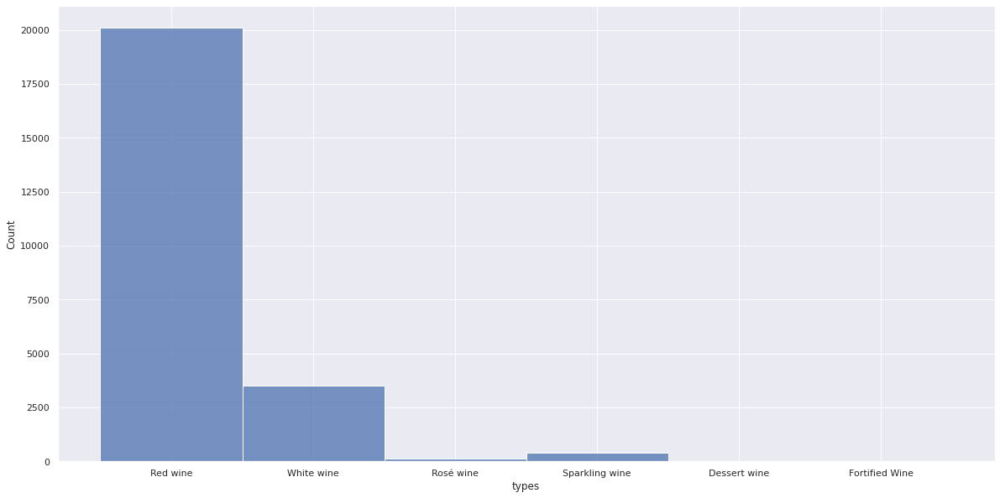

In [22]:
plt.figure(figsize=(20,10))
sns.histplot(df['types'])

--------------------------------------------------------------------------------------------

As we have such a small number of bottles in terms of dessert, fortified, rise and sparkling wine we are going to exlude these from future analysis, as no sensible data training can be done on so little data.

In [23]:
df = df[((df['types'] == 'Red wine') | (df['types'] == 'White wine' ))]

In [24]:
df.shape

(23632, 53)

In this subsection we will analysie the number of unique wines i.e. we no longer included the different vintages associated with each wine.

In [25]:
Dif_wines = df['types']
unique_wines = set(Dif_wines)         
unique_wines_count = len(unique_wines) 
len(df.wine_id.unique())  

5582

As shown above, there are a total of 5,582 different unique wines in the dataframe, when excluding different vintages. However, we want to see how the split among the differen unique types of wines is as well. This is done below.

In [26]:
df.groupby('types')['wine_id'].nunique()

types
Red wine      4648
White wine     934
Name: wine_id, dtype: int64

As we see from the above unique split between of wines look very similar to the overall split between different types of wine incl. different vintages. We find that the proportion of unique red wines is 83.27 % which is similar to the previous findings. Lastly, we find that the dataset contains 934 unique white wines, constituting 16.73 % of all unique wines. 

This is shown in the histogram below.

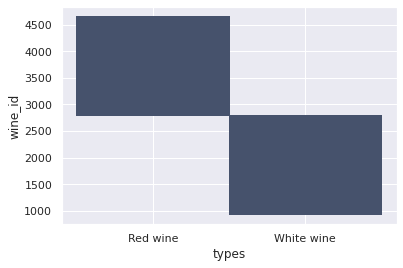

In [27]:
df_unique = df.groupby('types')['wine_id'].nunique()
df_unique = pd.DataFrame(df_unique)
df_unique.reset_index(inplace=True)
df_unique
sns.histplot(df_unique,x='types',y='wine_id')  #Fix graph later

The preliminary business conclusion that we can make is that our models will probably be better at forecasting and predicting the average rating of red wines, since the vast amount of the data concerns red wine. Therefore, as a start-up our business focus will predominately be geared towards the import and retailing of red-wine, however, white wine could be relevant when looking to expand our product offering.

### Countries represented


In [28]:
import folium

In this section of the exploratory analysis we look at the number of unique wines each country has.

In [29]:
df_country = df.groupby(['country_name','types'])['wine_id'].nunique()   #Number of Wines per Country (we could consider merging for Wine type as well, so that we can see the split per country on red, white and sparkling

In [30]:
df_country = pd.DataFrame(df_country)

In [31]:
df_country

wine_id
country_name types              
Argentina    Red wine        299
             White wine       18
Australien   Red wine        223
             White wine       35
Brasilien    Red wine         12
Canada       Red wine          7
             White wine        1
Chile        Red wine        272
             White wine       45
Frankrig     Red wine        908
             White wine      149
Grækenland   Red wine         12
             White wine        4
Israel       Red wine          6
Italien      Red wine       1046
             White wine      198
Japan        White wine        1
Mexico       Red wine          8
             White wine        2
New Zealand  Red wine         24
             White wine       81
Portugal     Red wine        212
             White wine       46
Schweiz      Red wine          2
             White wine        1
Spanien      Red wine        507
             White wine       45
Sydafrika    Red wine         80
             White wine       37
Tyskland     Red wine          4
             White wine       67
USA          Red wine        997
             White wine      179
Ungarn       Red wine          1
Uruguay      Red wine         14
Østrig       Red wine         14
             White wine       25

In [32]:
df_country.reset_index(inplace=True)

In [33]:
#df.groupby(['country_name','types'])['wine_id'].nunique().sum()  #Checking that the sum is 5829

In [34]:
df_map = df_country.groupby('country_name').sum()

In [35]:
df_map.reset_index(inplace=True)

As expected, both France, Italy and the USA is the larges producers of different types of wines. However, in order to visualize this more extensively, we are plotting a geographical map below.

In [36]:
translations = {'translations': {'Australien': 'Australia', 'Brasilien': 'Brazil', 'Frankrig': 'France', 'Grækenland': 'Greece', 'Italien': 'Italy', 'Schweiz': 'Switzerland', 'Spanien': 'Spain', 'Sydafrika': 'South Africa', 'Tyskland': 'Germany', 'USA': 'United States of America', 'Ungarn': 'Hungary', 'Østrig': 'Austria', 'Armenien': 'Armenia', 'Belgien': 'Belgium', 'Bolivia': 'Bolivia', 'Bulgarien': 'Bulgaria', 'Cypern': 'Cyprus', 'Georgien': 'Georgia', 'Holland': 'Netherlands', 'Indien': 'India', 'Kina': 'China', 'Kroatien': 'Croatia', 'Libanon': 'Lebanon', 'Marokko': 'Morocco', 'Republikken Makedonien': 'Macedonia', 'Republikken Moldova': 'Moldova', 'Rumænien': 'Romania', 'Rusland': 'Russia', 'Slovenien': 'Slovenia', 'Storbritannien': 'United Kingdom', 'Tjekkiet': 'Czech Republic', 'Tyrkiet': 'Turkey', 'Ukraine': 'Ukraine'}}
for item in translations['translations']:
  df_map['country_name'] = df_map['country_name'].str.replace(item,translations['translations'][item])

In [ ]:
def create_chrolopleth(df_map, legend_name, name='Name'):
    print(df_map)
    geo = 'https://raw.githubusercontent.com/datasets/geo-countries/master/data/countries.geojson'
    map1 = folium.Map([0, 0], tiles='cartodbpositron', zoom_start=3)
    tiles = ['stamenwatercolor', 'cartodbpositron', 'openstreetmap', 'stamenterrain']

    for tile in tiles:
        folium.TileLayer(tile).add_to(map1)
    
    
    choropleth = folium.Choropleth(
        geo_data = geo,
        name = 'choropleth',
        data = df_map,
        columns = [df_map.columns[0], df_map.columns[1]],
        key_on = 'properties.ADMIN',
        fill_color = 'YlGn',
        fill_opacity = 0.7,
        line_opacity = 0.2,
        legend_name = legend_name, # Voter Proportion (%) in 2019
        highlight = True).add_to(map1)

    folium.LayerControl().add_to(map1)
    # Display Region Label
    choropleth.geojson.add_child(
        folium.features.GeoJsonTooltip(['ADMIN'], labels=False)
    )
    return map1

create_chrolopleth(df_map, 'legend_name', name='Name')

### Reviews 

In [ ]:
df['reviews_count'].sum()  #This match the DataFrame, thus nothing is wrong here

7765392

As shown from the output above, the vintages of wines included in the dataframe have been reviwed a total of 7,765,392 times.

In [ ]:
#reviews = df.groupby('types')['reviews_count'].sum()
#reviews = reviews[reviews > 129775].index
#reviews_df = df['types'].isin(reviews)
#f = df[df['Unnamed: 0'].isin(reviews_df[reviews_df==True].index)]

In [ ]:
df.groupby('types')['reviews_count'].sum() #This one is ok

types
Red wine      6808944
White wine     956448
Name: reviews_count, dtype: int64

As we see from the above results, there are substantial difference between the number of reviews between the different types of wines. Note that for this explorative analysis, we look at all wines including the different vintages. 

We find that a total of 7,765,392 reviews have been conducted across the 23632, vintages of vines. Red wine accounts for 6,808,944 of those reviews, constituting 87.68 %. White wine accounts for 12.32 % of the conducted reviews.

### Overview of preliminary findings

Before moving on to more in-depht explorative data analysis we have constructed a dataframe containing the key findings across different wine types.

## Hypothesis 1: Price drives rating

** Tal me Markussen om at få "pris-farver" ind**

In [ ]:
plt.style.use('ggplot')

In [ ]:
df.head()

In [ ]:
red_df = df[df['types']=='Red wine']

In [ ]:
plt.scatter(x=red_df['price'], y=red_df['ratings_average'], c = red_df['price'],  cmap='viridis')
plt.colorbar(); 
red_df[['price','ratings_average']].corr()

In [ ]:
white_df = df[df['types']=='White wine']

In [ ]:
plt.scatter(x=white_df['price'], y=white_df['ratings_average'], c = white_df['price'],  cmap='viridis')
plt.colorbar(); 
white_df[['price','ratings_average']].corr()

As we see from the above results, there exists inter-linkage between price and rating for a variety of different types of wines when looking at the price range 50-6,000 DKK.

The inter-linkage appears to be largest for red wine, as we witness a large increase in average rating given a very low increase in price, and this increase in rating remains stable as prices increase.

Similar findings are present for white wine, however, not to the same degree as for red wine.

Out of the two types of wines, red wine's average rating have the largest correlation to price at 0.5119 as opposed to 0.4417 for white wine. To find out whether these are statistically significant a hypothesis test is needed.


## Hypothesis 2: Old is better than new

In [ ]:
## Red wine plot
plt.figure(figsize=(30,10))
plt.scatter(x=red_df['year'], y=red_df['ratings_average'], c=red_df['price'],cmap='viridis')
plt.colorbar(); 
red_df[['year', 'ratings_average']].corr()

In [ ]:
## White wine
plt.figure(figsize=(30,10))
plt.scatter(x=white_df['year'], y=white_df['ratings_average'], c=white_df['price'],cmap='viridis' )
white_df[['year', 'ratings_average']].corr()

As shown from the results above the interesting findings are that red wine is negatively correlated with time at -0.3157. The average rating of white wine seems to be close to uncorrelated to time. In order to figure out whether these are significant we will develop hypothesis test for these findings in future analysis.

## Hypothesis 3 - Italian and French wines dominate ratings

**Get number of observations for each country included**

In [ ]:
## Red wine
sns.boxplot(x='country_name',y='ratings_average',data=red_df, )

In [ ]:
## Red wine
sns.boxplot(x='country_name',y='price',data=red_df, )

In [ ]:
df.groupby(['country_name','types'])['median_price'].mean()

country_name  types     
Argentina     Red wine      180.782438
              White wine    135.879853
Australien    Red wine      202.120228
              White wine    125.538750
Brasilien     Red wine      102.586774
Canada        Red wine      168.304545
              White wine     70.700000
Chile         Red wine      156.465908
              White wine     87.898936
Frankrig      Red wine      525.547451
              White wine    232.700110
Grækenland    Red wine      127.740870
              White wine    200.597500
Israel        Red wine      188.036667
Italien       Red wine      293.891290
              White wine    119.694708
Japan         White wine    156.040000
Mexico        Red wine      122.439302
              White wine    122.982500
New Zealand   Red wine      197.982759
              White wine    123.132514
Portugal      Red wine      180.078158
              White wine    130.234643
Schweiz       Red wine       82.776000
              White wine     77.470000


In [ ]:
sns.boxplot(x='country_name',y='ratings_average',data=white_df)

In [ ]:
df.groupby(['country_name','types'])['median_price'].mean()

country_name  types     
Argentina     Red wine      180.782438
              White wine    135.879853
Australien    Red wine      202.120228
              White wine    125.538750
Brasilien     Red wine      102.586774
Canada        Red wine      168.304545
              White wine     70.700000
Chile         Red wine      156.465908
              White wine     87.898936
Frankrig      Red wine      525.547451
              White wine    232.700110
Grækenland    Red wine      127.740870
              White wine    200.597500
Israel        Red wine      188.036667
Italien       Red wine      293.891290
              White wine    119.694708
Japan         White wine    156.040000
Mexico        Red wine      122.439302
              White wine    122.982500
New Zealand   Red wine      197.982759
              White wine    123.132514
Portugal      Red wine      180.078158
              White wine    130.234643
Schweiz       Red wine       82.776000
              White wine     77.470000


As we see from the boxplots above, it appears that Italy, France, the USA and Spain have similar maximum average ratings across their different red vines. However, France, Italy and the US all have better minimum average ratings in terms of their red wine, when compared to Spain. Therefore, evidence suggest that if you want the best quality with the lowest variance, then you are better off with either French, Italien or American red wine

As seen from the second boxplot, it appears that New Zealand and Portugese white wine dominates the spectrum closely followed by French white wines. New Zealand has a higher minimum average rating than portgual, however, portugal scores higher in terms of maximum average rating, and also in terms of median value. Therefore, evidence suggests that the highest quality white wine is found either in New Zealand or Portgual.

# Hypothesis 4 - Old is more expensive than new

In [ ]:
## Red wine
plt.scatter(x=red_df['year'], y=red_df['price'])
red_df[['year','price']].corr()

,year,price
year,1.000000,-0.317354
price,-0.317354,1.000000


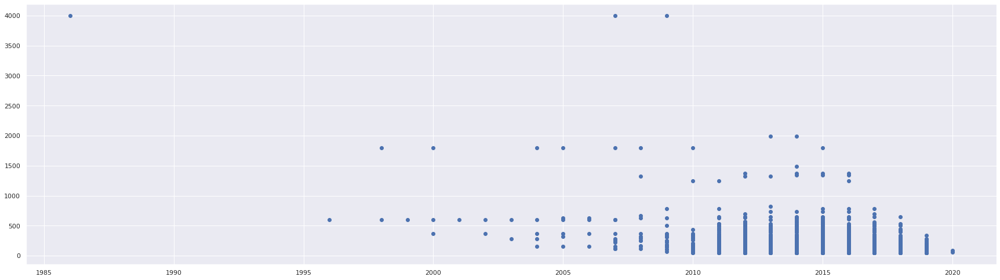

In [ ]:
## White wine
plt.scatter(x=white_df['year'], y=white_df['price'])
white_df[['year','price']].corr()

In both cases we find that there exists a negative correlation between price and year i.e. the closer we get to present the less we expect wines to costs. This is congruent with the findings that old is better than new.

## Regression Loop

Due to the relative insignificant findings related to dessert and fortified wine, we have decided to drop the categories from the dataset.

In [ ]:
# We want to regress on all the nummerical variables, thus we select the appropriate dtypes.
numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
df_num = df.select_dtypes(include=numerics)

In [ ]:
df_num = df_num.drop(columns=['wine_id','winery_id']) #Drop these

In [ ]:
df_num.head()

,year,ratings_count,ratings_average,labels_count,reviews_count,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,users_count,regions_count,wines_count,wineries_count,median_price,price,top_world_pct,top_region_pct,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors
1,2014,1358,4.4,6279,407,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,248.89,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0
2,2012,1118,4.2,3841,336,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,206.73,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0
3,2013,1675,4.4,6678,532,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,289.69,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0
4,2011,1607,4.2,5377,585,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,325.00,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0
5,2015,726,4.4,3174,236,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,255.98,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0


In [ ]:
fit_d = {}

for col in [x for x in df_num.columns if x != 'ratings_average']:
    Y = df_num['ratings_average'] #
    Y = Y[Y.notnull()] #Remove NaNs

    X = df_num[col]
    X = X[X.notnull()] #Remove NaNs

    X = sm.add_constant(X) #Add constant to fit line

    reg = sm.OLS(Y,X).fit()
    r2 = reg.rsquared
    pval = reg.pvalues[1]

    fit_d[col] = r2


    #fit_d[col].predict(sm.add_constant(df[col]))

fit_d

pd.DataFrame(fit_d, index=fit_d.keys()).iloc[0,:].T.sort_values(ascending=False).round(4)

top_world_pct             0.7469
winery_ratings_average    0.5588
top_region_pct            0.3810
price                     0.2559
median_price              0.1573
total_flavors             0.1147
year                      0.0921
earthy                    0.0815
yeasty                    0.0680
winery_wines_count        0.0666
red fruit                 0.0579
dried fruit               0.0367
oaky                      0.0350
lamb                      0.0344
game                      0.0269
wines_count               0.0254
wineries_count            0.0242
regions_count             0.0217
veal                      0.0175
floral                    0.0154
tree fruit                0.0148
citrus                    0.0126
vegetal                   0.0123
winery_labels_count       0.0118
vegetarian                0.0100
users_count               0.0094
ageing                    0.0087
black fruit               0.0066
spices                    0.0066
tropical                  0.0051
beef      

As shown above, we find that the price variable explains 25.59 % of the variance of the dependent parameter (average rating) in the regression model.

This is in line with general consensus suggesting that rating is correlated to price. However, price is obviously not the full explanation behind the variance found in the average rating. 

Additionally, we find that independent variables such as "total flavours", "top world pct" and "top region pct" explain 11.47 %, 74.69 % and 38.10 % respectively. It is no surprise that the last two mentioned independent variables have a high explanatory power of the variance of the dependent variable, as they are interconnected with the dependent variable by nature.

Going forward, we will drop variables that are inherently interconnected with the dependent varible to avoid multiculinarity. 


### How much of the dependent variable's variance can be explained if we include all nummerical independent variables excl. the afforementioned variables?

In [ ]:
Y = df_num['ratings_average'] #
Y = Y[Y.notnull()] #Remove NaNs

X = df_num[[x for x in df_num.columns if x != 'ratings_average' and x != 'top_region_pct' and x != 'top_world_pct']]
X = X[X.notnull()] #Remove NaNs
X = sm.add_constant(X) #Add constant to fit line

#fit_d['labels_count'] = sm.OLS(Y,X).fit()
#fit_d['labels_count'].predict(sm.add_constant(df['labels_count']))
reg = sm.OLS(Y,X).fit()
reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        ratings_average   R-squared:                       0.662
Model:                            OLS   Adj. R-squared:                  0.662
Method:                 Least Squares   F-statistic:                     1285.
Date:                Fri, 20 Nov 2020   Prob (F-statistic):               0.00
Time:                        13:57:48   Log-Likelihood:                 6795.0
No. Observations:               23632   AIC:                        -1.352e+04
Df Residuals:                   23595   BIC:                        -1.322e+04
Df Model:                          36                                         
Covariance Type:            nonrobust                                         
==========================================================================================
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                     -4.8428      0.653     -7.422      0.000      -6.122      -3.564
year                       0.0032      0.000      9.144      0.000       0.003       0.004
ratings_count          -8.958e-05   6.66e-06    -13.450      0.000      -0.000   -7.65e-05
labels_count            8.935e-07   2.77e-07      3.230      0.001    3.51e-07    1.44e-06
reviews_count              0.0003    1.9e-05     13.564      0.000       0.000       0.000
winery_ratings_count    7.872e-07   7.26e-08     10.842      0.000    6.45e-07     9.3e-07
winery_ratings_average     0.7116      0.007    106.289      0.000       0.698       0.725
winery_labels_count    -1.195e-07      1e-08    -11.899      0.000   -1.39e-07   -9.98e-08
winery_wines_count         0.0002    2.6e-05      7.951      0.000       0.000       0.000
users_count             1.367e-09   6.19e-10      2.208      0.027    1.53e-10    2.58e-09
regions_count          -5.532e-05   1.94e-05     -2.848      0.004   -9.34e-05   -1.73e-05
wines_count             7.947e-07   1.13e-07      7.013      0.000    5.73e-07    1.02e-06
wineries_count         -5.058e-06   1.08e-06     -4.685      0.000   -7.17e-06   -2.94e-06
median_price            1.057e-05   2.55e-06      4.139      0.000    5.56e-06    1.56e-05
price                   9.905e-05   4.13e-06     23.978      0.000     9.1e-05       0.000
oaky                      -0.1629      0.054     -3.020      0.003      -0.269      -0.057
black fruit               -0.6070      0.056    -10.904      0.000      -0.716      -0.498
red fruit                 -1.1055      0.056    -19.649      0.000      -1.216      -0.995
earthy                    -0.0321      0.055     -0.584      0.559      -0.140       0.076
spices                    -0.2440      0.063     -3.876      0.000      -0.367      -0.121
ageing                     0.0040      0.127      0.031      0.975      -0.245       0.253
yeasty                    -1.7447      0.088    -19.858      0.000      -1.917      -1.572
dried fruit                0.9979      0.074     13.531      0.000       0.853       1.143
citrus                    -0.6639      0.065    -10.258      0.000      -0.791      -0.537
tree fruit                -0.9716      0.061    -15.975      0.000      -1.091      -0.852
vegetal                   -0.7525      0.092     -8.217      0.000      -0.932      -0.573
floral                     0.7144      0.114      6.261      0.000       0.491       0.938
tropical                  -0.2749      0.067     -4.075      0.000      -0.407      -0.143
beef                      -0.0903      0.010     -9.266      0.000      -0.109      -0.071
lamb                       0.0019      0.005      0.413      0.679      -0.007       0.011
veal                       0.0098      0.004      2.317      0.021       0.002  

As shown in the output above, when regressing on all the nummerical independent variables, excluding 'wine_id', 'Unnamed: 0', 'Unnamed: 0.1', 'winery_id', 'region_id' and 'median_price' we end up with an adjusted R^2 of 0.824 which is quite satisfactory given that we are in the initial stage of the analysis.

### What if we incl. price, reviews and total flavors?

In [ ]:
Y = df_num['ratings_average'] #
Y = Y[Y.notnull()] #Remove NaNs

X = df_num[['price', 'reviews_count', 'total_flavors']]
X = X[X.notnull()] #Remove NaNs
X = sm.add_constant(X) #Add constant to fit line

#fit_d['labels_count'] = sm.OLS(Y,X).fit()
#fit_d['labels_count'].predict(sm.add_constant(df['labels_count']))
reg = sm.OLS(Y,X).fit()
reg.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        ratings_average   R-squared:                       0.295
Model:                            OLS   Adj. R-squared:                  0.294
Method:                 Least Squares   F-statistic:                     3288.
Date:                Fri, 20 Nov 2020   Prob (F-statistic):               0.00
Time:                        13:57:54   Log-Likelihood:                -1910.4
No. Observations:               23632   AIC:                             3829.
Df Residuals:                   23628   BIC:                             3861.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const             3.7255      0.002   1534.729      0.000       3.721       3.730
price             0.0003   4.09e-06     72.617      0.000       0.000       0.000
reviews_count -2.837e-05   4.91e-06     -5.772      0.000    -3.8e-05   -1.87e-05
total_flavors  4.971e-05   1.56e-06     31.892      0.000    4.67e-05    5.28e-05
==============================================================================
Omnibus:                      372.117   Durbin-Watson:                   0.735
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              489.123
Skew:                          -0.218   Prob(JB):                    6.14e-107
Kurtosis:                       3.554   Cond. No.                     2.72e+03
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.72e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

As shown above, if we regress on only 3 variables including "price", "reviews_count" and "total_flavors" we get an adjusted R^2 of 0.294. This highlights that price, reviews and flavors are not the only significant explanatory factors when tasked with forecasting average rating. Therefore, in order to find relevant wines to our start-up we have to be deliberate about the limitations and possibilities already at this stage.

### Pairplot

In [ ]:
#df_pairplot = df.drop(columns=['Unnamed: 0', 'Unnamed: 0.1', 'wine_id', 'winery_id','winery_name', 'currency','median_type','foods','average_ratings','net_follower_score'])

In [ ]:
#sns.pairplot(df_pairplot, hue='types', kind="reg", corner=True)

In [ ]:
df.head()

,Unnamed: 0,Unnamed: 0.1,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region_id,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,currency,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,average_ratings,net_follower_score,types
1,1,1,2014,1358,4.4,6279,407,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,248.89,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
2,2,2,2012,1118,4.2,3841,336,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,206.73,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
3,3,3,2013,1675,4.4,6678,532,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,289.69,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
4,4,4,2011,1607,4.2,5377,585,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,325.00,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
5,5,5,2015,726,4.4,3174,236,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,255.98,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,3.784904,0.896567,Red wine


## Hypothesis Testing

### Hypothesis 3: Are French red wines really better?

In order to figure out whether the correlation above are statistically significant we will make a hypothesis test using the student's t-distribution.



In [ ]:
red_df.head()

,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region_id,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,currency,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,average_ratings,net_follower_score,types
1,2014,1358,4.4,6279,407,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,248.89,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
2,2012,1118,4.2,3841,336,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,206.73,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
3,2013,1675,4.4,6678,532,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,289.69,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
4,2011,1607,4.2,5377,585,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,325.00,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,NaN,NaN,Red wine
5,2015,726,4.4,3174,236,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,255.98,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,3.784904,0.896567,Red wine


In [ ]:
from scipy.stats import ttest_ind
import scipy.stats
from scipy.stats import ttest_1samp

H0: Average rating France = Average rating remaining countries

H1: Average rating France > Average rating remaining countries 

In [ ]:
length_fr = red_df[(red_df['country_name']=='Frankrig')]


In [ ]:
Ratings_France = length_fr['ratings_average']  ## Here we hav all the ratings from France

In [ ]:
df_fr = red_df.groupby('country_name')['ratings_average'].mean()  ##All the average ratings means per country


In [ ]:
length_other = red_df[(red_df['country_name']!='Frankrig')] ##Subsetting to select everything besides France

In [ ]:
Ratings_others = length_other['ratings_average']  #All ratings for other countries

In [ ]:
Ratings_others_mean = length_other['ratings_average'].mean()  #Mean of all wine ratings besides France

In [ ]:
ttest_ind(Ratings_France,Ratings_others)

Ttest_indResult(statistic=15.146600004414324, pvalue=1.535867983001718e-51)

and since according to the documentation this is the output for a two-tailed t-test we must divide the p by 2 for our one-tailed test. 

In [ ]:
pvalue = 1.535867983001617e-51/2
alpha = 0.05

In [ ]:
if pvalue < alpha:
  print('Reject H0')
else:
  print('Accept H0')


Reject H0


From out analysis it seems that french red wines are significantly better in terms of rating when compared to the rest of the world. 

## PCA and UMAP

In [ ]:
from sklearn.preprocessing import StandardScaler

In [ ]:
df_num['types'] = df['types']

In [ ]:
df_num.head()

,year,ratings_count,ratings_average,labels_count,reviews_count,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,users_count,regions_count,wines_count,wineries_count,median_price,price,top_world_pct,top_region_pct,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,types
1,2014,1358,4.4,6279,407,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,248.89,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
2,2012,1118,4.2,3841,336,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,206.73,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
3,2013,1675,4.4,6678,532,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,289.69,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
4,2011,1607,4.2,5377,585,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,325.00,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine
5,2015,726,4.4,3174,236,119738,4.0,457778,47,484656.0,37.0,41242.0,4656.0,255.98,138.55,1.0,1.0,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,Red wine


In [ ]:
Model = StandardScaler()  #Instantiate scaler
scaled_num = StandardScaler().fit_transform(df_num.loc[:,'year':'total_flavors'])

In [ ]:
# Let's import PCA
from sklearn.decomposition import PCA
pca = PCA(n_components=2) # we explicitly ask for 2 components

In [ ]:
pca_num = pca.fit_transform(scaled_num)

In [ ]:
pca_num.shape

(23632, 2)

The two components should now contains information that describes the data but where the information within the two should be maximally dissimilar. 
Since we now have 2 dimension describing each observation, we can plot them against each other in a scatterplot.

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


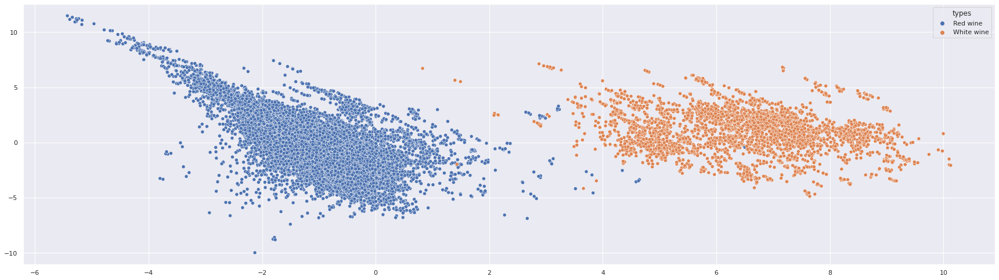

In [ ]:
sns.scatterplot(pca_num[:,0], pca_num[:,1], hue = df_num['types'])


In [ ]:
pca.explained_variance_ratio_

array([0.20770646, 0.12929775])

# Conclusions 

Red wine seems to have a slightly higher median rating compared to White wine and Sparkling wine.


There is a strong correlation between rating and price for red wine, white wine, and sparkling wine.


Older red wines have a more narrow rating range, while younger wines have a wider rating range.


Red wines from the USA have a generally higher median rating compared to the remaining countries in the scraped dataset.


Red wine ratings have a significantly higher variance compared to white wine ratings.


The scraped data contains no evidence for that red wines from French have significantly higher rating compared to the remaining countries in the dataset.


Looking for high rating wine below $30 based on more than 100 reviews? Look for wines in the USA.


53% of the rating per bottle can be explained by the price and number of reviews.


Selenium as a scraping tool is significantly slower than Beautifulsoup and 


Scrapy. Thus, the structure of the site (infinite scroll) forced me in this direction.

## DatePrep Analysis (use for generating plots etc) (very clean)

### Glimpse of the data

In [ ]:
df.head()

,vintage_id,year,ratings_count,ratings_average,labels_count,reviews_count,wine_id,is_natural,winery_id,winery_name,winery_ratings_count,winery_ratings_average,winery_labels_count,winery_wines_count,country_name,region_id,region,users_count,regions_count,wines_count,wineries_count,most_used_grapes,currency,median_price,median_type,price,foods,top_world_pct,top_region_pct,bold,tannic,sweet,oaky,black fruit,red fruit,earthy,spices,ageing,yeasty,dried fruit,citrus,tree fruit,vegetal,floral,tropical,beef,lamb,veal,poultry,pork,shellfish,vegetarian,game,spicy-food,total_flavors,Wine type
0,22505105,2015,481,3.7,4992,138,1577018,False,6802,Espíritu de Chile,26413,3.5,334302,90,Chile,593,Central Valley,255535.0,37.0,47366.0,4995.0,"[{'Cabernet Sauvignon': 2}, {'Carménère': 51},...",DKK,44.31,user,32.85,"beef, lamb, game, poultry",6.0,4.0,74.2759,47.0701,35.4162,0.000000,0.00000,0.666667,0.000000,0.000000,0.000000,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,3.0,1
1,5625084,2014,1358,4.4,6279,407,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,248.89,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,2
2,2117077,2012,1118,4.2,3841,336,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,206.73,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,2
3,2223038,2013,1675,4.4,6678,532,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,289.69,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,1
4,2386146,2011,1607,4.2,5377,585,1153456,False,14299,Pulenta Estate,119738,4.0,457778,47,Argentina,454,Mendoza,484656.0,37.0,41242.0,4656.0,"[{'Malbec': 9}, {'Cabernet Sauvignon': 2}, {'C...",DKK,325.00,user,138.55,"beef, lamb, poultry",1.0,1.0,67.668,37.1303,19.5674,0.331671,0.27182,0.137157,0.112219,0.062344,0.007481,0.014963,0.017456,0.002494,0.007481,0.009975,0.024938,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,401.0,0


In [ ]:
plot(df)   #Column level statistics

### Deep dive on relevant data columns 


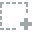
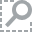
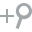
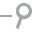
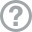
...
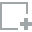
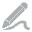
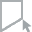
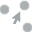
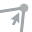

In [ ]:
plot(df,'ratings_average')   #Column level statistics

### Uncovering Correlated variables - removing useless features

In [ ]:
plot_correlation(df,'ratings_average')  #Correlation of reviews and followers count

### Deep Dive on correlated variables

In [ ]:
plot(df_num, 'ratings_average', "price") ##Understand the realtionship between data (x,y)

### Overall Report

In [ ]:
report = create_report(df,title ='XXX')

In [ ]:
# Findings of potential correlations (to be investigated by Hypothesis test)

# 1. test whether rating is driven by price
# 2. Test aging against rating
# 3. Test citrus (negative correlation it seems)
# 4. Test tropical (negative correlation it seems)
# 5. Test total flavours (Aboslutely the best correlation among all !)
# 6. Test number of reviews against rating (need to consolidate data frames for that)

XXX
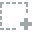
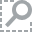
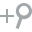
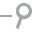
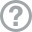
...
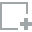
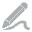
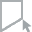
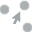
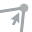

In [ ]:
report

In [ ]:
report.show_browser()

##

In [ ]:
reviews = df.groupby('types')['reviews_count'].sum()
reviews = reviews[reviews > 2486].index
reviews_df = df['types'].isin(reviews)
df = df[df['Unnamed: 0'].isin(reviews_df[reviews_df==True].index)]

# 1. test whether rating is driven by price
# 2. Test aging against rating
# 3. Test citrus (negative correlation it seems)
# 4. Test tropical (negative correlation it seems)
# 5. Test total flavours (Aboslutely the best correlation among all !)
# 6. Test number of reviews against rating (need to consolidate data frames for that)